In [129]:
import numpy as np
import pickle

In [130]:
from sklearn.datasets import load_iris
from sklearn import tree
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.metrics import confusion_matrix

## Load the features

In [131]:
with open('../cache/features','rb') as f:
    X, y, imgNames = pickle.load(f)
X.shape

(598, 7)

In [132]:
X[:5,]

array([[6.50116269e-01, 8.84444444e-01, 1.46666667e-01, 3.09375000e-03,
        9.15909468e-05, 1.39064730e-03, 1.48223825e-03],
       [6.19079247e-01, 8.85572139e-01, 2.73631841e-01, 2.45000000e-01,
        2.46011732e-03, 8.84071434e-03, 6.38059701e-03],
       [6.13969990e-01, 9.73451327e-01, 2.52212389e-01, 2.67187500e-02,
        4.47602804e-03, 8.45250545e-03, 3.97647741e-03],
       [5.52679613e-01, 9.20000000e-01, 2.66666667e-01, 1.67000000e-01,
        1.50507608e-03, 2.57064507e-03, 4.07572115e-03],
       [6.19940488e-01, 7.68888889e-01, 2.44444444e-01, 2.81250000e-04,
        1.50082981e-03, 8.85281304e-04, 2.38611111e-03]])

In [133]:
y.mean()

0.5635451505016722

## Evalutate a Decision Tree Model via Cross-Validation

In [134]:
clf = tree.DecisionTreeClassifier(min_samples_leaf=5).fit(X, y)

In [135]:
scores = cross_val_score(clf, X, y, cv=10)
print("Accuracy: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Accuracy: 0.66 (+/- 0.17)


In [136]:
y_pred = cross_val_predict(clf, X, y, cv=10)
confusion_matrix(y, y_pred)

array([[171,  90],
       [100, 237]])

In [137]:
import graphviz 
dot_data = tree.export_graphviz(clf, out_file=None,   
                         filled=True, rounded=True,  
                         special_characters=True)
graph = graphviz.Source(dot_data) 
graph.render("decicition_tree") 

'decicition_tree.pdf'

## Look at bad examples

In [138]:
from PIL import Image
import imageio

def printWaterfall(file):
    im = imageio.imread(file)
    display(Image.fromarray(im))

[0.07291125 0.60571429 0.49142857 0.42046875 0.00184253 0.00763858
 0.00948111]


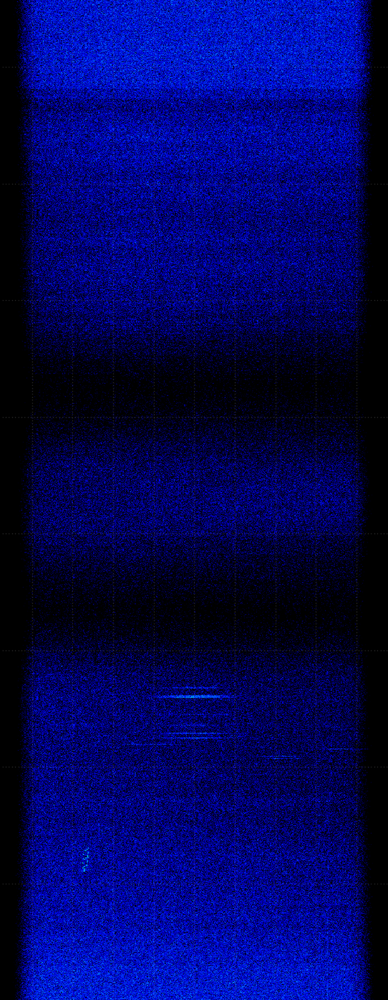

[0.74080655 0.99557522 0.25221239 0.0960625  0.00350906 0.02272286
 0.02623192]


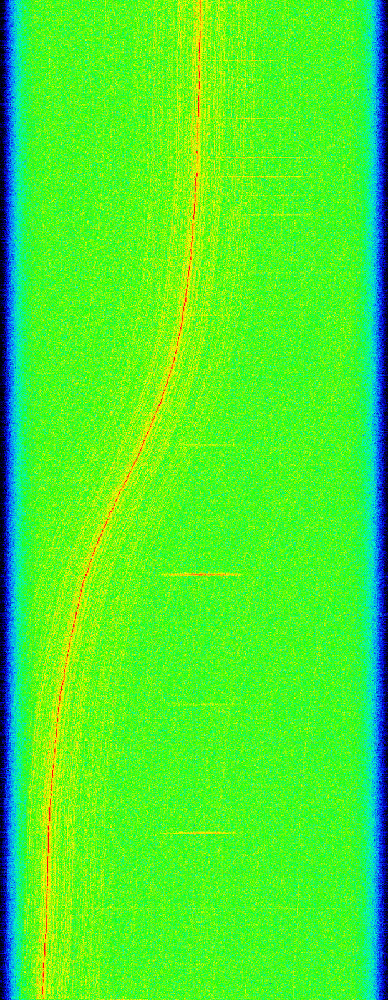

[8.42744579e-01 9.95594714e-01 1.85022026e-01 0.00000000e+00
 3.63679017e-04 9.08038979e-04 5.44359963e-04]


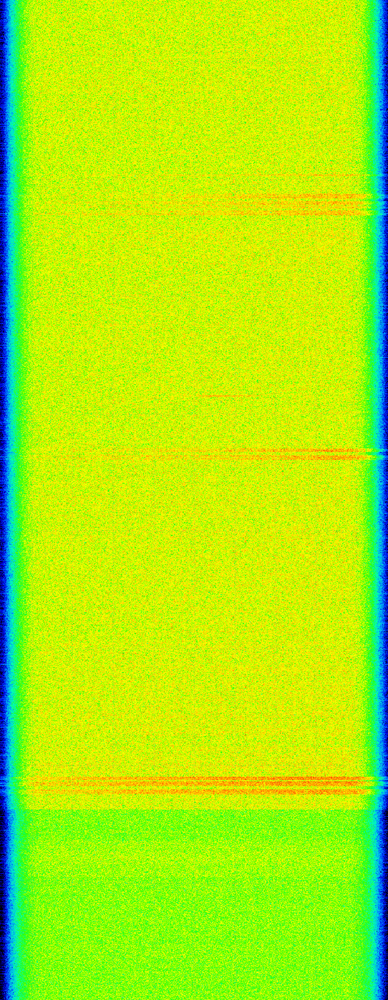

[0.63004696 0.81415929 0.15929204 0.00246875 0.00247022 0.00263517
 0.00510538]


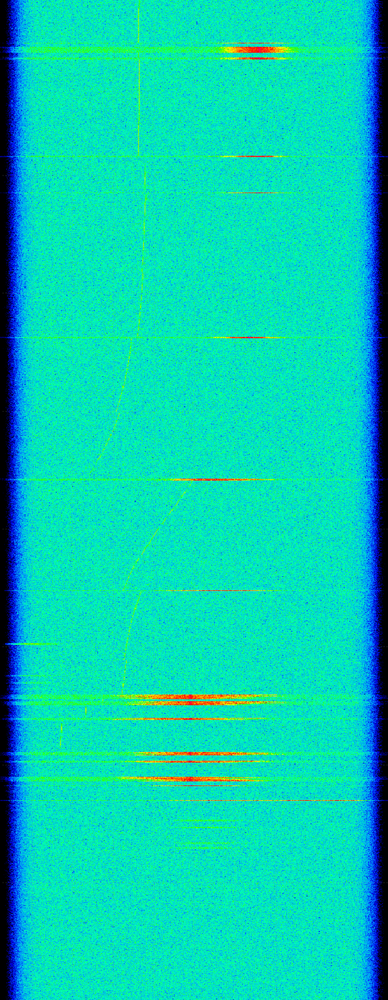

[7.03683873e-01 9.95575221e-01 1.85840708e-01 5.84375000e-02
 1.92866650e-03 9.84720583e-04 2.91338708e-03]


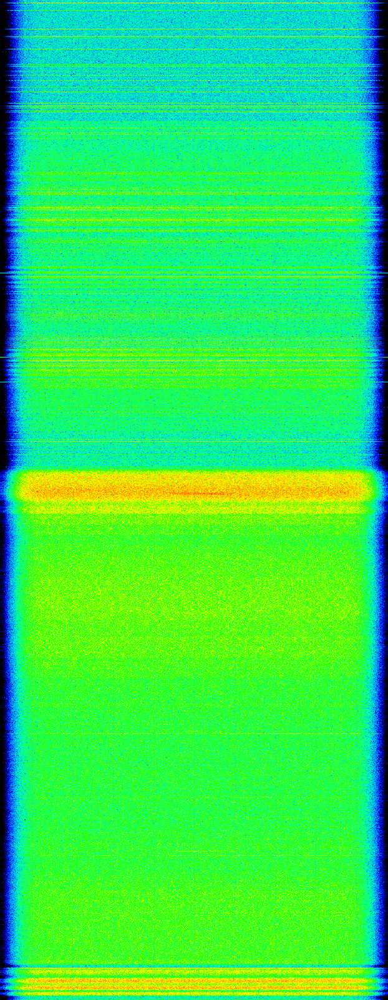

In [139]:
is_false_negative = np.where(np.logical_and(y == 1, y_pred == 0))[0]
for idx in is_false_negative[5:10]:
    print(X[idx])
    printWaterfall('../data/cropped/good/' + imgNames[idx])

[7.81073640e-01 0.00000000e+00 2.21357274e-03 1.53709872e-03
 3.75067147e-03 6.76474017e-04]


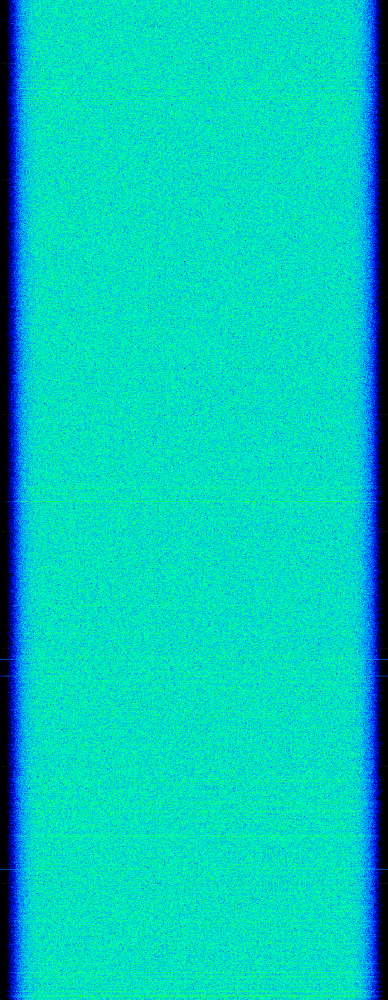

[0.17727309 0.3575     0.02360043 0.0810716  0.10467202 0.05747117]


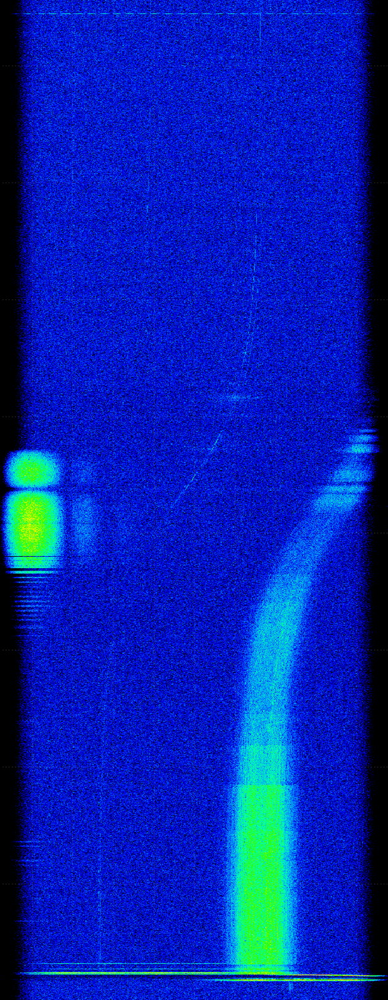

[0.03140481 0.629375   0.00551901 0.00260963 0.00812864 0.00290938]


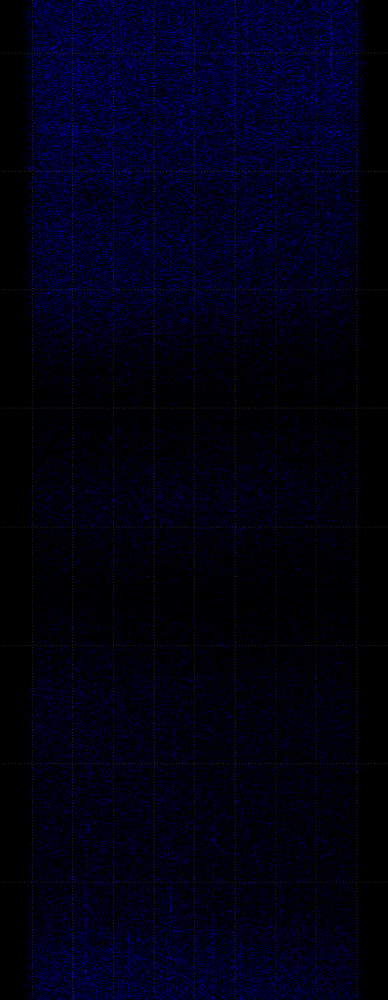

[0.36619167 0.441875   0.01331625 0.01225163 0.00106462 0.00106462]


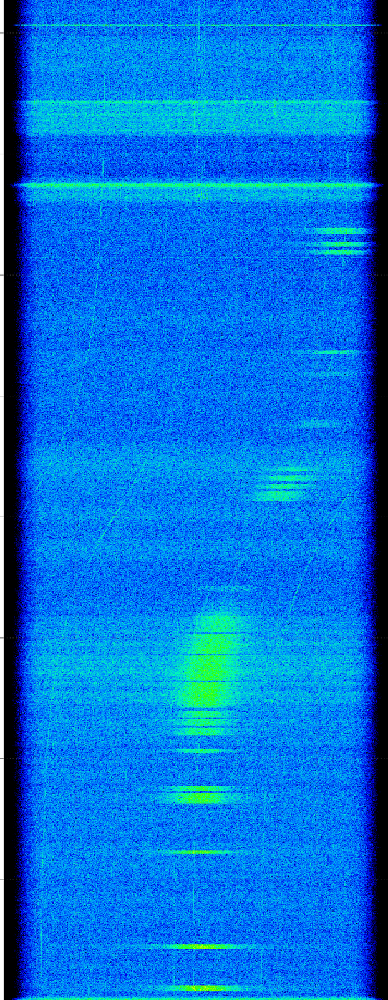

[0.43517129 0.42375    0.0033511  0.00123242 0.00458352 0.00211867]


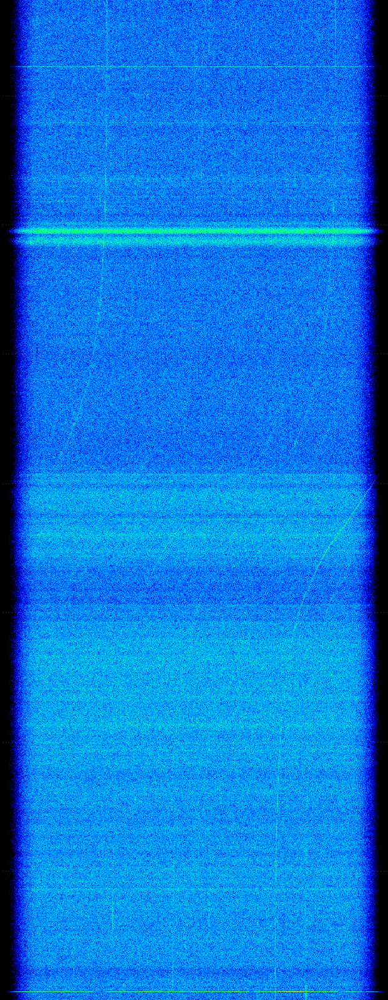

In [93]:
is_false_positive = np.where(np.logical_and(y == 0, y_pred == 1))[0]
for idx in is_false_positive[:5]:
    print(X[idx])
    printWaterfall('../data/cropped/bad/' + imgNames[idx])